# Evolution du chiffre d'affaire mensuel 

Concernant l'évolution du CA à la demande d'Antoine. On va s'interesser à l'évolution mensuelle. Dans une variable ca_par_mois, je vais calculer le CA par mois , grace aux méthodes .groupby et .sum()

In [75]:
ca_par_mois = reelles_transactions.groupby(pd.Grouper(key='date', freq='M')).sum().reset_index()
ca_par_mois

,date,birth,price,categ,year,month,day
0,2021-03-31,56586044.00,482530.52,11806.00,57820810,85830,455478
1,2021-04-30,56291346.00,476249.16,10623.00,57511597,113828,444079
2,2021-05-31,55962533.00,493023.39,11461.00,57180153,141465,452290
3,2021-06-30,53123224.00,484158.49,12640.00,54277997,161142,415950
4,2021-07-31,48945808.00,482875.36,13151.00,50003582,173194,390208
5,2021-08-31,50762218.00,482374.70,11890.00,51856839,205272,412970
6,2021-09-30,65896890.00,507360.56,11076.00,67351846,299934,542698
7,2021-10-31,42755324.00,320868.67,4008.00,43665726,216060,350218
8,2021-11-30,56002521.00,516267.63,15106.00,57236741,311531,439293
9,2021-12-31,64184688.00,525987.21,14051.00,65609744,389568,532025


Un peu brouillon, on va créer une colonne "vente en milliers d'euros" en divisant le CA mensuel par 1000. On ne gardera que les colonne pertinentes à savoir date et la colonne nouvellement créée

In [76]:
ca_par_mois["Vente en milliers d'euros"] = round (ca_par_mois.price / 1000,3)
ca_par_mois = ca_par_mois[['date', "Vente en milliers d'euros"]]
ca_par_mois.head()

,date,Vente en milliers d'euros
0,2021-03-31,482.53
1,2021-04-30,476.25
2,2021-05-31,493.02
3,2021-06-30,484.16
4,2021-07-31,482.88


Voilà qui est un peu plus lisible ! 

Passon à la création du graphique : 

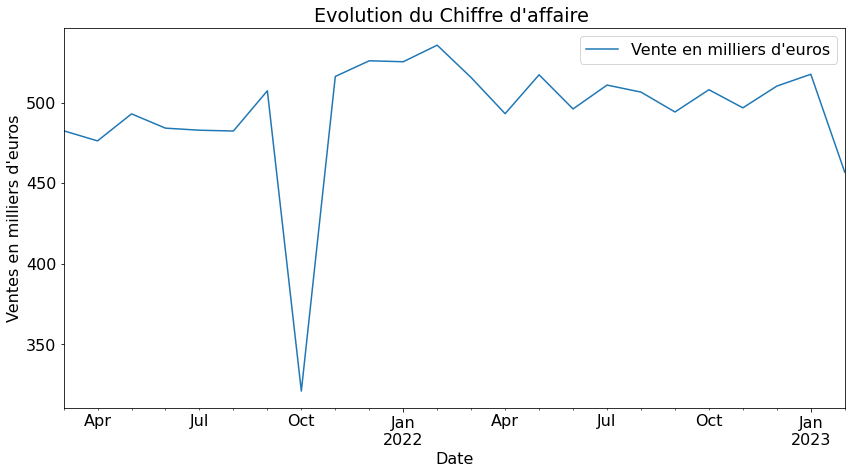

In [276]:
ca_par_mois.plot(x='date', y="Vente en milliers d'euros")
plt.title("Evolution du Chiffre d'affaire ")
plt.xlabel('Date')
plt.ylabel("Ventes en milliers d'euros")

plt.show()

Oula ! Il semble y avoir un problème. On passe de 500.000 euros de chiffre d'affaire en septembre à moins de 350.000 euros en octobre pour repasser à plus 500.000 euros en Novembre. Une chose est sûre : même si la cause de cette baisse brutale est incertaine, ce n'est pas normal !

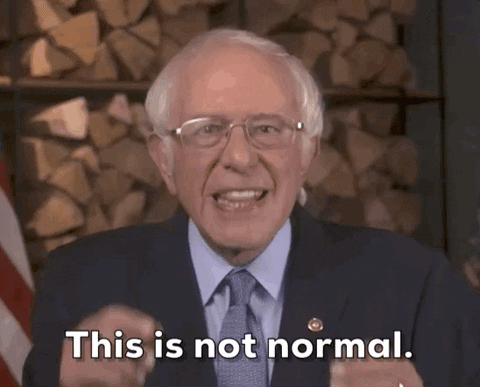

Passée la suprise, il faut penser à un moyen d'élucider ce mystère. On passe certe de 500.000 euros de chiffre d'affaire en septembre à moins de 350.000 euros en octobre pour repasser à plus 500.000 euros en Novembre. Mais qu'en est-il du nombre de vente ? 
La baisse a t-elle été tout aussi brutale de ce côté ? 

In [79]:
nb_ventes_par_mois = reelles_transactions.groupby(pd.Grouper(key='date', freq='M')).count().reset_index()

In [80]:
nb_ventes_par_mois.head()

,date,id_prod,session_id,client_id,sex,birth,price,categ,year,month,day
0,2021-03-31,28610,28610,28610,28610,28610,28610,28610,28610,28610,28610
1,2021-04-30,28457,28457,28457,28457,28457,28457,28457,28457,28457,28457
2,2021-05-31,28293,28293,28293,28293,28293,28293,28293,28293,28293,28293
3,2021-06-30,26857,26857,26857,26857,26857,26857,26857,26857,26857,26857
4,2021-07-31,24742,24742,24742,24742,24742,24742,24742,24742,24742,24742


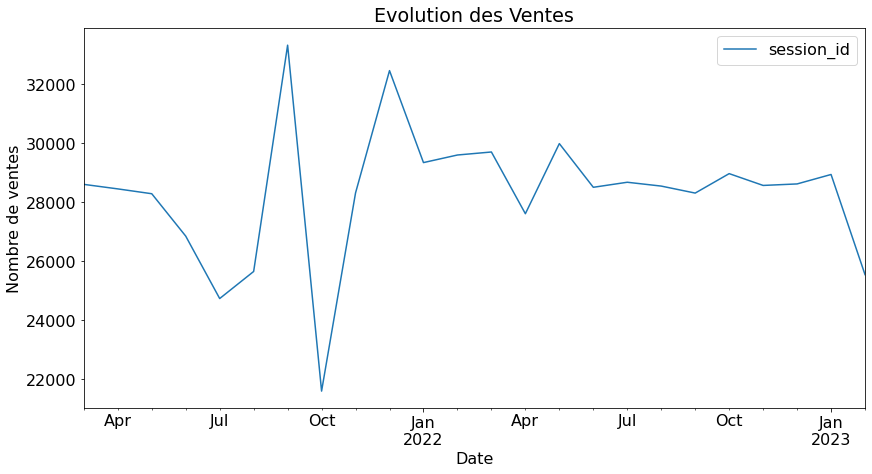

In [280]:
nb_ventes_par_mois.plot(x='date', y="session_id")

plt.title("Evolution des Ventes")
plt.xlabel('Date')
plt.ylabel("Nombre de ventes")
plt.show()


Bingo ! Le problème vient effectivement du nombre de vente. On passe d'environ 33.000 ventes en septembre a 22 000 en octobre soit près de 33%  de baisse . 
En résumé, on enregistre moins de chiffre d'affaire pendant le mois d'octobre. Cette baisse est associé à un nombre de vente en chute libre ( baisse d'un tiers de notre nombre de vente en l'espace d'un mois ). 
Le fait que le mois de Novembre connaisse un remontée aussi fulgurante, tend à faire poindre chez moi, un soupçon ; celui que on ait eu un problème d'acquisition des données 
Peut-on aller plus loin ? 
Oui. Et si on s'interressait au nombre de vente par catégorie pendant le mois d'octobre ?

In [82]:
display(reelles_transactions[(reelles_transactions.categ == 0) & (reelles_transactions.date > '2021-10-01') & (reelles_transactions.date < '2021-10-31')])
# Avec cette ligne de code je cherche dans mon df reelles_transactions les lignes qui correspondent
# aux produits de catégorie 0 vendus entre le 1er et le 31 Octobre 2021.

display(reelles_transactions[(reelles_transactions.categ == 1) & (reelles_transactions.date > '2021-10-01') & (reelles_transactions.date < '2021-10-31')])
# Avec cette ligne de code je cherche dans mon df reelles_transactions les lignes qui correspondent
# aux produits de catégorie 1 vendus entre le 1er et le 31 Octobre 2021.

display(reelles_transactions[(reelles_transactions.categ == 2) & (reelles_transactions.date > '2021-10-01') & (reelles_transactions.date < '2021-10-31')])
# Avec cette ligne de code je cherche dans mon df reelles_transactions les lignes qui correspondent
# aux produits de catégorie 2 vendus entre le 1er et le 31 Octobre 2021.

,id_prod,date,session_id,client_id,sex,birth,price,categ,year,month,day
377762,0_1145,2021-10-01 00:00:23.722317,s_98170,c_5907,f,1991.00,6.99,0.00,2021,10,1
180186,0_2268,2021-10-01 00:06:04.960675,s_98172,c_2588,m,1989.00,17.57,0.00,2021,10,1
64560,0_1421,2021-10-01 00:07:50.987959,s_98173,c_5953,m,1986.00,19.99,0.00,2021,10,1
677470,0_890,2021-10-01 00:09:04.987008,s_98174,c_5277,m,1976.00,2.81,0.00,2021,10,1
191480,0_1405,2021-10-01 00:12:40.001099,s_98174,c_5277,m,1976.00,4.99,0.00,2021,10,1
...,...,...,...,...,...,...,...,...,...,...,...
370666,0_1432,2021-10-30 23:41:20.520952,s_112468,c_3812,f,1964.00,15.36,0.00,2021,10,30
436847,0_578,2021-10-30 23:56:21.158070,s_112475,c_4557,m,1983.00,11.16,0.00,2021,10,30
305058,0_1574,2021-10-30 23:56:25.127556,s_112471,c_6664,f,1990.00,9.67,0.00,2021,10,30
519831,0_1201,2021-10-30 23:58:45.761214,s_112478,c_6268,m,1991.00,10.99,0.00,2021,10,30


,id_prod,date,session_id,client_id,sex,birth,price,categ,year,month,day
168694,1_622,2021-10-01 00:03:07.095422,s_98169,c_7614,m,1995.00,17.41,1.00,2021,10,1
439501,1_202,2021-10-01 00:03:16.664480,s_98171,c_4492,f,1980.00,19.96,1.00,2021,10,1
14431,1_397,2021-10-01 00:15:08.771899,s_98175,c_7176,f,1951.00,18.99,1.00,2021,10,1
498898,1_619,2021-10-01 00:21:30.028255,s_98178,c_4848,m,1953.00,12.99,1.00,2021,10,1
387761,1_669,2021-10-01 00:21:41.000160,s_98179,c_1773,f,1995.00,15.99,1.00,2021,10,1
...,...,...,...,...,...,...,...,...,...,...,...
16761,1_367,2021-10-30 23:54:32.007668,s_112473,c_3202,m,1954.00,13.99,1.00,2021,10,30
246817,1_533,2021-10-30 23:55:23.497733,s_112474,c_5016,f,2004.00,11.99,1.00,2021,10,30
615877,1_588,2021-10-30 23:57:30.681241,s_112468,c_3812,f,1964.00,12.62,1.00,2021,10,30
13706,1_257,2021-10-30 23:57:37.718187,s_112476,c_1301,m,2001.00,22.99,1.00,2021,10,30


,id_prod,date,session_id,client_id,sex,birth,price,categ,year,month,day
654565,2_173,2021-10-01 01:04:24.546960,s_98189,c_5908,m,1964.00,155.99,2.00,2021,10,1
654957,2_33,2021-10-01 01:05:35.151879,s_98195,c_737,f,1994.00,30.99,2.00,2021,10,1
638412,2_155,2021-10-01 01:15:00.331838,s_98201,c_2309,f,2004.00,46.99,2.00,2021,10,1
640913,2_104,2021-10-01 01:39:15.279306,s_98208,c_2341,f,1999.00,43.35,2.00,2021,10,1
646045,2_115,2021-10-01 01:46:17.014944,s_98197,c_1805,f,1995.00,50.99,2.00,2021,10,1
...,...,...,...,...,...,...,...,...,...,...,...
654217,2_136,2021-10-30 20:28:11.573569,s_112412,c_2656,f,1999.00,103.92,2.00,2021,10,30
651908,2_202,2021-10-30 20:37:14.137812,s_112417,c_4745,f,2004.00,67.57,2.00,2021,10,30
625531,2_160,2021-10-30 21:28:13.449378,s_112433,c_6755,m,1977.00,62.83,2.00,2021,10,30
581773,2_46,2021-10-30 22:14:53.265279,s_112450,c_7467,m,2000.00,41.31,2.00,2021,10,30


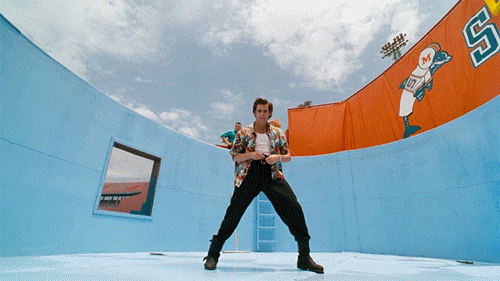

Ok, ce qui saute aux yeux, c'est que **rien ne saute aux yeux** ! On va procéder autrement ! On va essayer de créer un df où on aura pour chaque jour du mois d'octobre: 
_Le chiffre d'affaire  généré par **chaque catégorie de produit**, 
_et les **nombre de ventes** de chacune de ces dernières.
Commençons par créer un **df qui regroupe toute les transactions du mois d'Octobre** qu'on enregistre dans une variable **"reelles_transactions_octobre"**.

In [83]:
reelles_transactions_octobre = reelles_transactions.loc[(reelles_transactions["year"] == 2021) & (reelles_transactions["month"] == 10)]

In [84]:
reelles_transactions_octobre

,id_prod,date,session_id,client_id,sex,birth,price,categ,year,month,day
377762,0_1145,2021-10-01 00:00:23.722317,s_98170,c_5907,f,1991.00,6.99,0.00,2021,10,1
168694,1_622,2021-10-01 00:03:07.095422,s_98169,c_7614,m,1995.00,17.41,1.00,2021,10,1
439501,1_202,2021-10-01 00:03:16.664480,s_98171,c_4492,f,1980.00,19.96,1.00,2021,10,1
180186,0_2268,2021-10-01 00:06:04.960675,s_98172,c_2588,m,1989.00,17.57,0.00,2021,10,1
64560,0_1421,2021-10-01 00:07:50.987959,s_98173,c_5953,m,1986.00,19.99,0.00,2021,10,1
...,...,...,...,...,...,...,...,...,...,...,...
486907,0_1108,2021-10-31 23:42:55.889671,s_112940,c_6259,m,1991.00,17.45,0.00,2021,10,31
196787,1_414,2021-10-31 23:48:14.590919,s_112948,c_1609,m,1980.00,23.83,1.00,2021,10,31
263754,0_1425,2021-10-31 23:51:26.167675,s_112949,c_1767,f,1983.00,12.99,0.00,2021,10,31
346250,0_1745,2021-10-31 23:55:21.654841,s_112950,c_3320,m,1976.00,4.99,0.00,2021,10,31


Il y a du mieux. Malheureusement cela reste encore **assez fouillis**. On va régler ça en ne gardant que **les colonnes les plus pertinentes.** 
On a pas besoin de la date étant donné qu'on s'interesse uniquement au mois d'Octobre, mais **la colonne "day" est pertinente.**
Etant donné qu'on s'interesse au **chiffre d'affaire et au nombre de vente** garder **la colonne "price"  est indipensable.**
Enfin colonne essentielle, **"categ" nous permettra de proceder à un  groupement**

In [85]:
reelles_transactions_octobre = reelles_transactions.loc[(reelles_transactions["year"] == 2021) & (reelles_transactions["month"] == 10), ["day", "price","categ"]]

In [86]:
reelles_transactions_octobre

,day,price,categ
377762,1,6.99,0.00
168694,1,17.41,1.00
439501,1,19.96,1.00
180186,1,17.57,0.00
64560,1,19.99,0.00
...,...,...,...
486907,31,17.45,0.00
196787,31,23.83,1.00
263754,31,12.99,0.00
346250,31,4.99,0.00


**Parfait,** ce qu'on cherchait à obtenir c'est pour chaque jour du mois d'octobre: 

_**Le chiffre d'affaire généré par chaque catégorie de produit**, 
_et **les nombre de ventes pour chacune de ces dernières.**

Il faudra donc **grouper par jour et par catégorie la somme des rangées "price" pour le chiffre d'affaire et le compte de ces rangées pour le nombre de vente.**
Pour ce faire on va utiliser les méthodes **.grouby()** et **.agg()**

In [87]:
reelles_transactions_octobre = reelles_transactions_octobre.groupby(["day","categ"]).agg({"price":["sum","count"]}).reset_index()

In [88]:
reelles_transactions_octobre

day categ   price      
                 sum count
0    1  0.00 6950.50   663
1    1  1.00 7003.79   344
2    1  2.00 3104.05    38
3    2  0.00 7141.01   661
4    2  2.00 2041.12    28
..  ..   ...     ...   ...
62  30  1.00 6753.69   338
63  30  2.00 2898.47    40
64  31  0.00 5924.07   555
65  31  1.00 7261.67   342
66  31  2.00 3219.38    41

[67 rows x 4 columns]

Bon, on voit un df avec une ligne par jour  et par categorie avec le nombre de vente et le Chiffre d'affaire. A vrai dire ... pas exactement c'est ce qu'on va changer avec notre prochaine ligne de code et la méthode **.columns**.
Changeons le noms des colonnes pour **Jour,, Catégorie, Chiffre d'affaire et Nb de vente**

In [89]:
reelles_transactions_octobre.columns = ["Jour", "Catégorie", "Chiffre d'affaire", "Nb de vente"]

Vérifions,

In [90]:
reelles_transactions_octobre

,Jour,Catégorie,Chiffre d'affaire,Nb de vente
0,1,0.00,6950.50,663
1,1,1.00,7003.79,344
2,1,2.00,3104.05,38
3,2,0.00,7141.01,661
4,2,2.00,2041.12,28
...,...,...,...,...
62,30,1.00,6753.69,338
63,30,2.00,2898.47,40
64,31,0.00,5924.07,555
65,31,1.00,7261.67,342


C'est une peu plus **lisible** ! Mais ça pourrait être mieux, essayons de créer un df dans lequel **les catégories seraient des colonnes et non des rangées.**
Pour se faire utilisons la méthode **.pivot_table et le paramètre columns**

In [91]:
reelles_transactions_octobre= pd.pivot_table(reelles_transactions_octobre, columns=["Catégorie"], index=["Jour"]).reset_index()

In [92]:
reelles_transactions_octobre

Jour Chiffre d'affaire                 Nb de vente             
Catégorie                    0.0     1.0     2.0         0.0    1.0   2.0
0            1           6950.50 7003.79 3104.05      663.00 344.00 38.00
1            2           7141.01     NaN 2041.12      661.00    NaN 28.00
2            3           6786.57     NaN 2206.48      648.00    NaN 31.00
3            4           6553.58     NaN 2746.08      603.00    NaN 38.00
4            5           6357.91     NaN 3032.55      594.00    NaN 38.00
5            6           7546.58     NaN 1944.11      702.00    NaN 26.00
6            7           6404.01     NaN 1787.07      597.00    NaN 26.00
7            8           7069.53     NaN 3137.82      669.00    NaN 44.00
8            9           6808.69     NaN 2616.67      640.00    NaN 35.00
9           10           6490.98     NaN 2334.67      600.00    NaN 29.00
10          11           7005.40     NaN 3225.16      642.00    NaN 42.00
11          12           6706.97     NaN 2264.18      633.00    NaN 30.00
12          13           6760.40     NaN 2666.82      633.00    NaN 36.00
13          14           6422.39     NaN 3047.39      606.00    NaN 40.00
14          15           6707.07     NaN 2701.75      634.00    NaN 38.00
15          16           6898.14     NaN 3330.88      661.00    NaN 45.00
16          17           6492.60     NaN 3065.38      625.00    NaN 44.00
17          18           6376.43     NaN 2707.29      608.00    NaN 37.00
18          19           5805.69     NaN 2816.00      567.00    NaN 37.00
19          20           5912.76     NaN 3118.42      555.00    NaN 42.00
20          21           6438.85     NaN 3132.94      610.00    NaN 43.00
21          22           6051.86     NaN 2416.00      572.00    NaN 35.00
22          23           5704.26     NaN 3206.38      555.00    NaN 47.00
23          24           6036.65     NaN 3886.54      584.00    NaN 44.00
24          25           5817.82     NaN 2258.22      545.00    NaN 32.00
25          26           6345.00     NaN 2685.78      592.00    NaN 36.00
26          27           5822.24     NaN 3967.29      530.00    NaN 49.00
27          28           5837.61 6317.99 2602.82      548.00 316.00 30.00
28          29           6410.57 6425.18 3617.88      595.00 326.00 50.00
29          30           5734.62 6753.69 2898.47      542.00 338.00 40.00
30          31           5924.07 7261.67 3219.38      555.00 342.00 41.00

Changeons à nouveau le nom des colonnes.

In [93]:
reelles_transactions_octobre.columns = ["Jour", "CA cat.0", "CA cat.1", 'CA cat.2', 'Nb vente cat.0', 'Nb vente cat.1', 'Nb vente cat.2']

Vérifions

In [94]:
reelles_transactions_octobre

,Jour,CA cat.0,CA cat.1,CA cat.2,Nb vente cat.0,Nb vente cat.1,Nb vente cat.2
0,1,6950.50,7003.79,3104.05,663.00,344.00,38.00
1,2,7141.01,NaN,2041.12,661.00,NaN,28.00
2,3,6786.57,NaN,2206.48,648.00,NaN,31.00
3,4,6553.58,NaN,2746.08,603.00,NaN,38.00
4,5,6357.91,NaN,3032.55,594.00,NaN,38.00
5,6,7546.58,NaN,1944.11,702.00,NaN,26.00
6,7,6404.01,NaN,1787.07,597.00,NaN,26.00
7,8,7069.53,NaN,3137.82,669.00,NaN,44.00
8,9,6808.69,NaN,2616.67,640.00,NaN,35.00
9,10,6490.98,NaN,2334.67,600.00,NaN,29.00


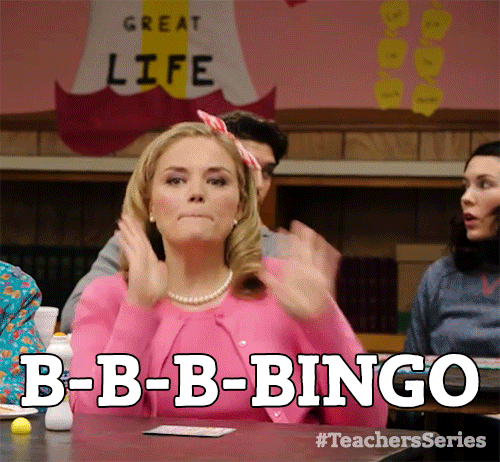

On a trouvé le problème :) !  Du **2 octobre au 27 inclus aucun produit de la catégorie 1 n'a été vendu**, ce qui fait beaucoup... il doit y avoir un problème au niveau de la **transmission des données.**  